In [2]:
import inspect
import time
from statistics import mean, stdev
from CybORG import CybORG
from CybORG.Agents import B_lineAgent, SleepAgent, GreenAgent
from CybORG.Agents.SimpleAgents.BaseAgent import BaseAgent
from CybORG.Agents.SimpleAgents.BlueReactAgent import BlueReactRemoveAgent
from CybORG.Agents.SimpleAgents.Meander import RedMeanderAgent
from CybORG.Agents.Wrappers.EnumActionWrapper import EnumActionWrapper
from CybORG.Agents.Wrappers.FixedFlatWrapper import FixedFlatWrapper
from CybORG.Agents.Wrappers.OpenAIGymWrapper import OpenAIGymWrapper
from CybORG.Agents.Wrappers.ReduceActionSpaceWrapper import ReduceActionSpaceWrapper
from CybORG.Agents.Wrappers import ChallengeWrapper
import os
from ray.rllib.agents.ppo import PPOTrainer
from ray.rllib.agents import ppo
from ray.tune.registry import register_env
from CybORG.Agents.Wrappers.rllib_wrapper import RLlibWrapper
import warnings
import ray
import numpy as np
warnings.filterwarnings('ignore')
config = ppo.DEFAULT_CONFIG.copy()
config

{'num_workers': 2,
 'num_envs_per_worker': 1,
 'create_env_on_driver': False,
 'rollout_fragment_length': 200,
 'batch_mode': 'truncate_episodes',
 'gamma': 0.99,
 'lr': 5e-05,
 'train_batch_size': 4000,
 'model': {'_use_default_native_models': False,
  '_disable_preprocessor_api': False,
  '_disable_action_flattening': False,
  'fcnet_hiddens': [256, 256],
  'fcnet_activation': 'tanh',
  'conv_filters': None,
  'conv_activation': 'relu',
  'post_fcnet_hiddens': [],
  'post_fcnet_activation': 'relu',
  'free_log_std': False,
  'no_final_linear': False,
  'vf_share_layers': False,
  'use_lstm': False,
  'max_seq_len': 20,
  'lstm_cell_size': 256,
  'lstm_use_prev_action': False,
  'lstm_use_prev_reward': False,
  '_time_major': False,
  'use_attention': False,
  'attention_num_transformer_units': 1,
  'attention_dim': 64,
  'attention_num_heads': 1,
  'attention_head_dim': 32,
  'attention_memory_inference': 50,
  'attention_memory_training': 50,
  'attention_position_wise_mlp_dim': 32,

In [9]:
MAX_EPS = 100
agent_name = 'Blue'

def wrap(env):
    return RLlibWrapper(agent_name="Blue", env=env)


def evaluate(steps):
    path = str(inspect.getfile(CybORG))
    path = path[:-10] + '/Shared/Scenarios/Scenario2.yaml'
    obs = []
    #print(f'using CybORG v{cyborg_version}, {scenario}\n')
    for num_steps in steps:
        for red_agent in [B_lineAgent]:

            cyborg = CybORG(path, 'sim', agents={'Red': red_agent})
            wrapped_cyborg = wrap(cyborg)

            observation = wrapped_cyborg.reset()
            obs.append(observation)
            # observation = cyborg.reset().observation

            action_space = wrapped_cyborg.get_action_space(agent_name)
            # action_space = cyborg.get_action_space(agent_name)
            total_reward = []
            actions = []
            for i in range(MAX_EPS):
                r = []
                a = []
                # cyborg.env.env.tracker.render()
                for j in range(num_steps):
                    action = trainer.compute_single_action(observation)
                    action_vec = np.zeros(145)
                    action_vec[int(action)] = 1
                    #action = agent.get_action(observation, action_space)
                    observation, rew, done, info = wrapped_cyborg.step(action)
                    obs.append(observation)
                    actions.append(action_vec)
                    # result = cyborg.step(agent_name, action)
                    r.append(rew)
                    # r.append(result.reward)
                    a.append((str(cyborg.get_last_action('Blue')), str(cyborg.get_last_action('Red'))))
                total_reward.append(sum(r))
                # observation = cyborg.reset().observation
                observation = wrapped_cyborg.reset()
            print(f'Average reward for red agent {red_agent.__name__} and steps {num_steps} is: {mean(total_reward):.1f} with a standard deviation of {stdev(total_reward):.1f}')
            return mean(total_reward), np.mean(np.array(obs), axis=0),  np.mean(np.array(actions), axis=0)

In [10]:
def env_creator(env_config: dict):
    path = str(inspect.getfile(CybORG))
    path = path[:-10] + '/Shared/Scenarios/Scenario2.yaml'
    agents = {"Red": B_lineAgent, "Green": GreenAgent}
    cyborg = CybORG(scenario_file=path, environment='sim', agents=agents)
    env = RLlibWrapper(env=cyborg, agent_name="Blue", max_steps=100)
    return env

def print_results(results_dict):
    train_iter = results_dict["training_iteration"]
    r_mean = results_dict["episode_reward_mean"]
    r_max = results_dict["episode_reward_max"]
    r_min = results_dict["episode_reward_min"]
    print(f"{train_iter:4d} \tr_mean: {r_mean:.1f} \tr_max: {r_max:.1f} \tr_min: {r_min: .1f}")

import subprocess
import json
import os

batch_size = 4000
# Set up CybORG
register_env(name="CybORG", env_creator=env_creator)
config = ppo.DEFAULT_CONFIG.copy()

from shutil import make_archive
allrewards = []
for g in [0.9]:
    config.update({"num_gpus": 1,"num_workers": 10,
                    # Also, use "framework: tf2" for tfe eager execution.
                    "framework": "tf2",
                    "train_batch_size": batch_size,
                    "horizon": 100,
                    "gamma": g,
                    "model": {
                        "fcnet_hiddens": [512, 512],
                        "fcnet_activation": "relu",
                    },
                   
                    }) 
    trainer = ppo.PPOTrainer(config=config, env="CybORG")

    reward = []
    novel_obs = []
    novel_actions = []
    for i in range(200):
        results_dict = trainer.train()
        r, o, a = evaluate([100])
        reward.append(r)
        novel_obs.append(o)
        novel_actions.append(a)
    print(g)
    removed = 0
    result = subprocess.run(['ls', "/ppo"], stdout=subprocess.PIPE)
    for j, name in enumerate(str(result.stdout)[2:].split('\\n')[0:-1]):
        f = open(os.path.join("/ppo", name))
        try:
            json.load(f)
        except ValueError as err:
            os.remove(os.path.join("/ppo", name)) 
            removed += 1
    print('Removed ' + str(removed) + ' files, of ' + str(j) + 'files')
    make_archive("ppo", 'zip', "/ppo")
    allrewards.append(reward)
    np.save('ppo_reward.npy', np.array(reward))
    np.save('ppo_novel_obs.npy', np.stack(novel_obs))
    np.save('ppo_novel_actions.npy', np.stack(novel_actions))
    #if i % int((1e6/batch_size)/20) == 0:
    #    evaluate([100])
#results = trainer.train()
#print_results(results)
novel

(RolloutWorker pid=32398) 2022-06-25 09:12:37,269	WARNING env.py:135 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(RolloutWorker pid=32399) 2022-06-25 09:12:37,391	WARNING env.py:135 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(RolloutWorker pid=32404) 2022-06-25 09:12:37,384	WARNING env.py:135 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(RolloutWorker pid=32406) 2022-06-25 09:12:37,451

Average reward for red agent B_lineAgent and steps 100 is: -356.3 with a standard deviation of 228.1
Average reward for red agent B_lineAgent and steps 100 is: -305.3 with a standard deviation of 194.6
Average reward for red agent B_lineAgent and steps 100 is: -258.9 with a standard deviation of 98.5
Average reward for red agent B_lineAgent and steps 100 is: -244.9 with a standard deviation of 98.8
Average reward for red agent B_lineAgent and steps 100 is: -253.7 with a standard deviation of 122.6
Average reward for red agent B_lineAgent and steps 100 is: -245.8 with a standard deviation of 121.4
Average reward for red agent B_lineAgent and steps 100 is: -209.5 with a standard deviation of 53.9
Average reward for red agent B_lineAgent and steps 100 is: -207.5 with a standard deviation of 79.9
Average reward for red agent B_lineAgent and steps 100 is: -223.8 with a standard deviation of 108.2
Average reward for red agent B_lineAgent and steps 100 is: -184.8 with a standard deviation of 

Average reward for red agent B_lineAgent and steps 100 is: -27.6 with a standard deviation of 21.0
Average reward for red agent B_lineAgent and steps 100 is: -31.3 with a standard deviation of 31.5
Average reward for red agent B_lineAgent and steps 100 is: -35.6 with a standard deviation of 35.7
Average reward for red agent B_lineAgent and steps 100 is: -29.2 with a standard deviation of 28.6
Average reward for red agent B_lineAgent and steps 100 is: -31.8 with a standard deviation of 31.3
Average reward for red agent B_lineAgent and steps 100 is: -32.7 with a standard deviation of 31.3
Average reward for red agent B_lineAgent and steps 100 is: -27.5 with a standard deviation of 28.3
Average reward for red agent B_lineAgent and steps 100 is: -29.0 with a standard deviation of 25.9
Average reward for red agent B_lineAgent and steps 100 is: -28.6 with a standard deviation of 28.2
Average reward for red agent B_lineAgent and steps 100 is: -32.3 with a standard deviation of 34.6
Average re

Average reward for red agent B_lineAgent and steps 100 is: -24.1 with a standard deviation of 23.0
Average reward for red agent B_lineAgent and steps 100 is: -25.2 with a standard deviation of 26.2
Average reward for red agent B_lineAgent and steps 100 is: -23.6 with a standard deviation of 28.2
Average reward for red agent B_lineAgent and steps 100 is: -23.1 with a standard deviation of 21.6
Average reward for red agent B_lineAgent and steps 100 is: -28.6 with a standard deviation of 30.3
Average reward for red agent B_lineAgent and steps 100 is: -27.0 with a standard deviation of 31.0
Average reward for red agent B_lineAgent and steps 100 is: -24.3 with a standard deviation of 29.2
Average reward for red agent B_lineAgent and steps 100 is: -20.3 with a standard deviation of 19.1
Average reward for red agent B_lineAgent and steps 100 is: -21.1 with a standard deviation of 20.7
Average reward for red agent B_lineAgent and steps 100 is: -24.2 with a standard deviation of 25.5
Average re

NameError: name 'j' is not defined

In [11]:
np.save('ppo_reward.npy', np.array(reward))
np.save('ppo_novel_obs.npy', np.stack(novel_obs))
np.save('ppo_novel_actions.npy', np.stack(novel_actions))

In [ ]:
std = []
for t in r:
    if t == []:
        break
    std.append(stdev(t))
    #print(stdev(t))
    
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(12,12))
plt.plot(range(2,23,2), std)
plt.title('Standard Deviation Over Trails ')
plt.xlabel('Number Evaluations')
plt.ylabel('STD between Trails')
plt.show()

In [ ]:
fig = plt.figure(figsize=(12,12))
plt.boxplot(r[1:], labels=[4,6,8,10,12,14,16,18,20,22,24])
plt.title('Box Plot For Evaluation Count Experiment')
plt.xlabel('Number Evaluations')
plt.ylabel('Reward')
plt.xlim([0,11])
plt.ylim([-60,-15])
plt.show()

In [ ]:
from math import factorial
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(12,12))
ax1 = fig.add_subplot(111)
gammas = [0.99, 0.9, 0.8, 0.7]
for i, l in enumerate(allrewards):
    ax1.plot(allrewards[i], label='gamma = ' + str(gammas[i]))

plt.legend(loc='upper left')
plt.title('Episode Length (passed though a Savitzky Golay filter)')
plt.xlabel('Episode')
plt.ylabel('Episode Length (timesteps)')
plt.show()

In [ ]:
from math import factorial
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(12,12))
ax1 = fig.add_subplot(111)
gammas = [.8]
for i, l in enumerate(allrewards):
    ax1.plot(allrewards[i], label='gamma = ' + str(gammas[i]))

plt.legend(loc='upper left')
plt.title('Mean Reward In Training Of PPO')
plt.xlabel('Batch')
plt.ylabel('Mean Reward')
plt.show()

In [ ]:
import ray
from ray import tune
from ray.rllib.agents.ppo import PPOTrainer
from ray.rllib.agents import ppo
from ray.rllib.agents.trainer import Trainer
trainer = ppo.PPOTrainer(config={"env": "CartPole-v0", "num_workers": 0, 'log_level': 'DEBUG'})
for i in range(2):
    trainer.train()

In [ ]:
from ray.rllib.agents import ppo
ppo.DEFAULT_CONFIG.copy()

In [ ]:
import inspect

def wrap(env):
    return RLlibWrapper(agent_name="Blue", env=env)


path = str(inspect.getfile(CybORG))
path = path[:-10] + '/Shared/Scenarios/Scenario1b.yaml'


cyborg = CybORG(path, 'sim', agents={'Red': B_lineAgent})
wrapped_cyborg = wrap(cyborg)

observation = wrapped_cyborg.reset()
#observation = cyborg.reset()

for i in range(100):
    observation, rew, done, info = wrapped_cyborg.step(0)

print(observation.shape)



In [ ]:
import matplotlib.pyplot as plt
import umap
from matplotlib import animation, rc
import numpy as np
import imageio

path = 'gagif'
if not os.path.exists('gagif'):
    os.mkdir(path)
evals_ppo = np.load('ppo_reward.npy')
evals_ga = np.load('85_data_a_evals.npy') 
whole = []
whole.append(np.load('85_data_a_archive.npy'))
whole.append(np.load('ppo_novel_actions.npy'))
#Comment out umap_embedding if adjusting plots after first run, its non-determeisitic 
#reducer = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.1)
#umap_embedding = reducer.fit_transform(np.concatenate(whole))
animation_frames = 200
num_ga_samples = np.load('85_data_a_archive.npy').shape[0]
start = 0
num_timesteps = 200
filenames = []
for i in range(num_timesteps): 
    fig = plt.figure(figsize=(12, 8), dpi=100)
    i_line = int(i*(num_timesteps/animation_frames))
    i_scatter = int(i*(num_samples/animation_frames)) #number of uMAP points to show for GA
    ax = plt.subplot(1, 2, 1)
    ax.set_xlim([-6,16])
    ax.set_ylim([-10,20]) 
    ax.set_title('uMAP of Action Embedding')
    ax1 = plt.subplot(1, 2, 2)
    ax1.set_xlim([0,200])
    ax1.set_ylim([-80,-15])
    ax1.set_title('Reward Accumilation')
    ax1.set_xlabel('Iteration')
    ax1.set_ylabel('Reward')
    ax1.plot(evals_ga[:i_line+1], label="GA Action Novelty - Elite Evaluation")
    ax1.plot(evals_ppo[:i_line+1], label="PPO - Evaluation")
    ax1.legend(loc='lower right')
    ax.scatter(umap_embedding[0:i_scatter+1,0], umap_embedding[0:i_scatter+1,1], alpha=0.1)
    ax.scatter(umap_embedding[num_ga_samples:num_ga_samples+i+1,0], umap_embedding[num_ga_samples:num_ga_samples+i+1,1], alpha=0.1)
    plt.savefig(path+'/'+str(i)+'.png')
    filenames.append(path+'/'+str(i)+'.png')

images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('cage2actionnovelty.gif', images, duration=0.1)

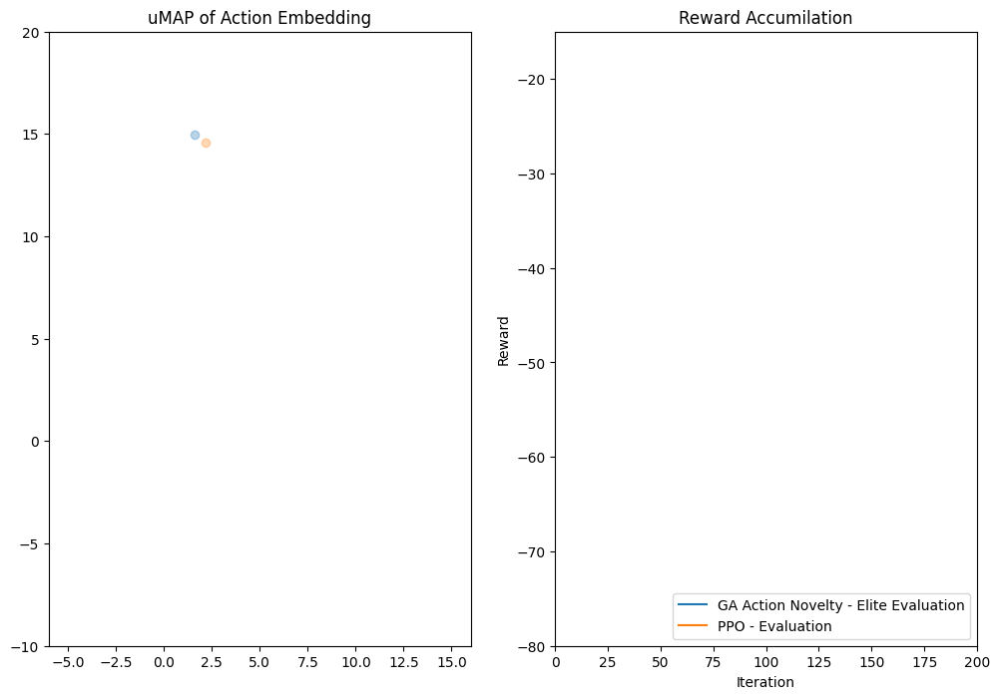

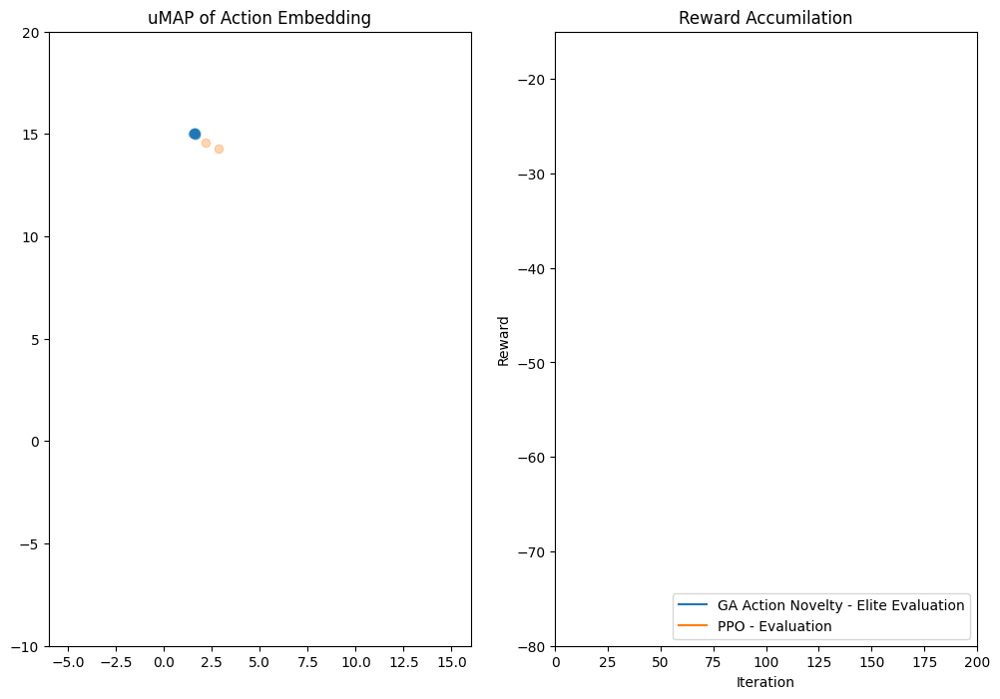

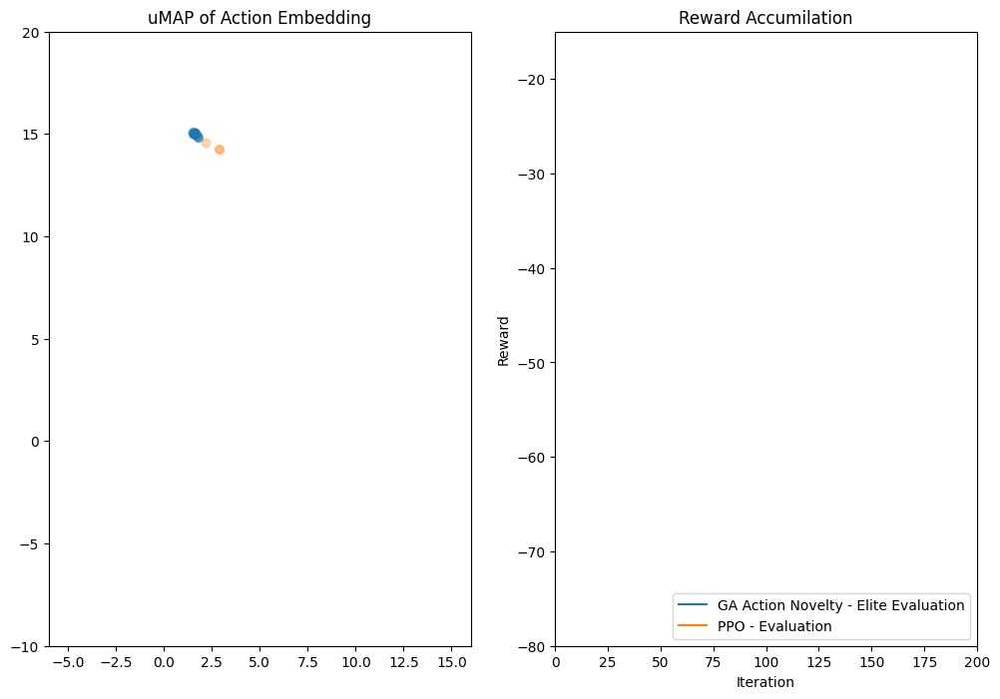

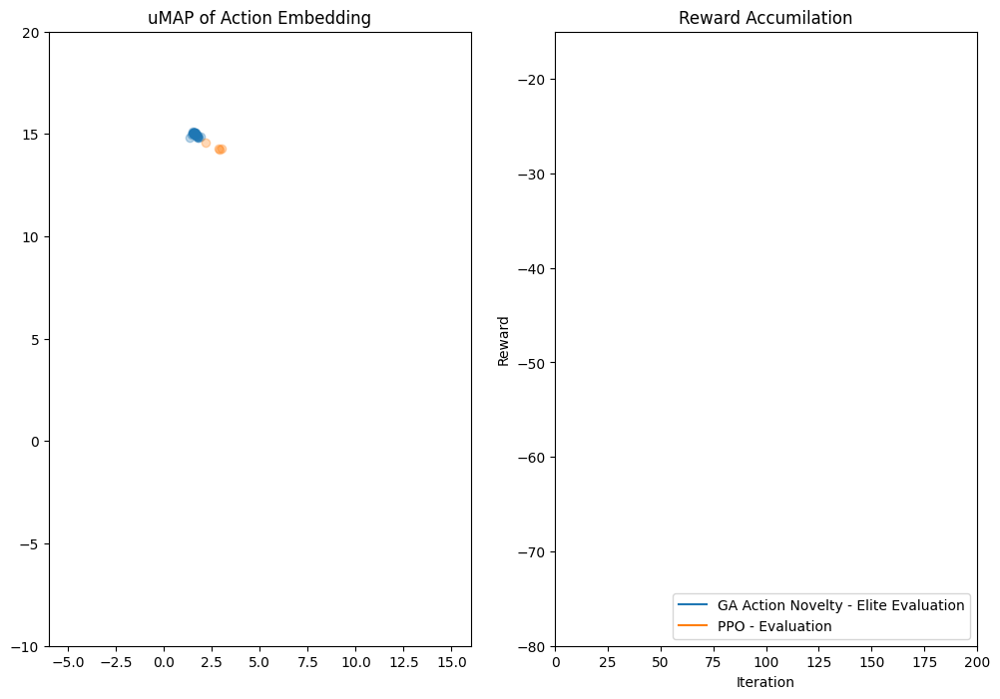

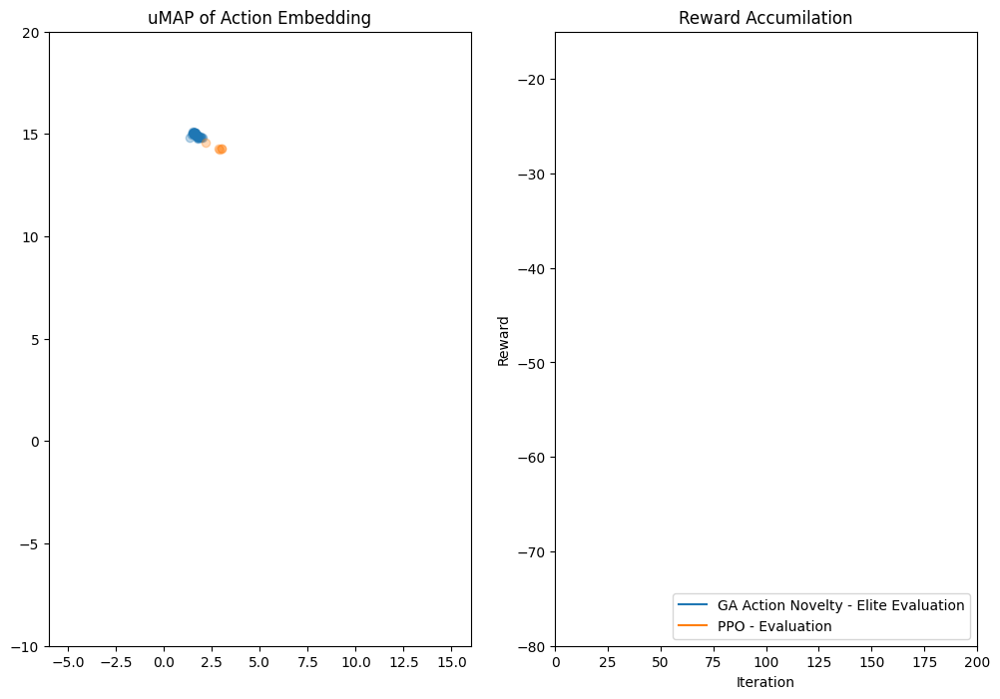

...

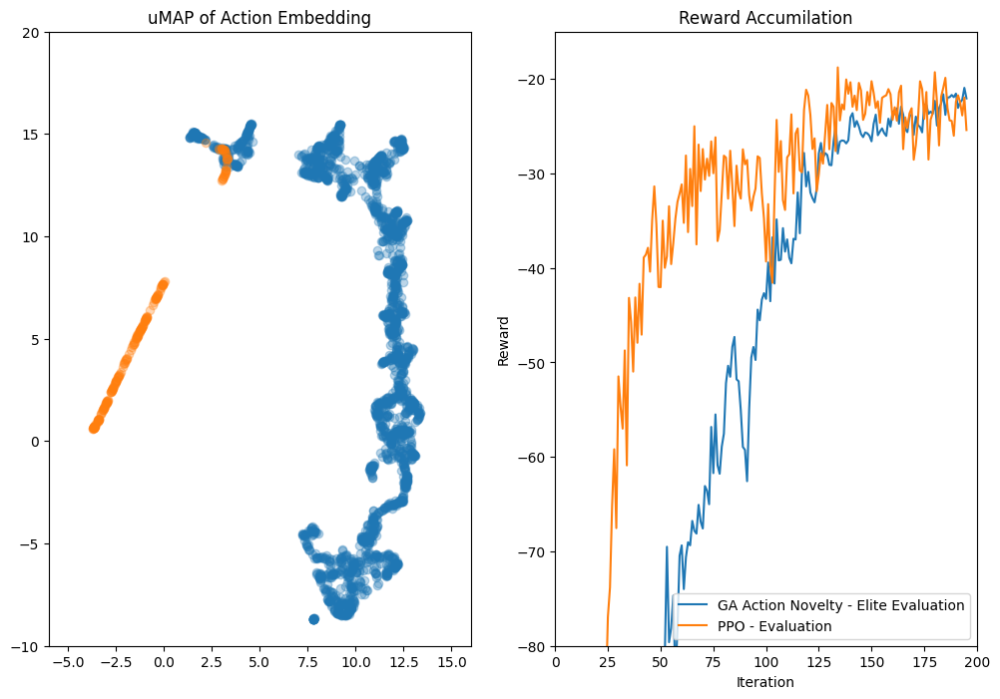

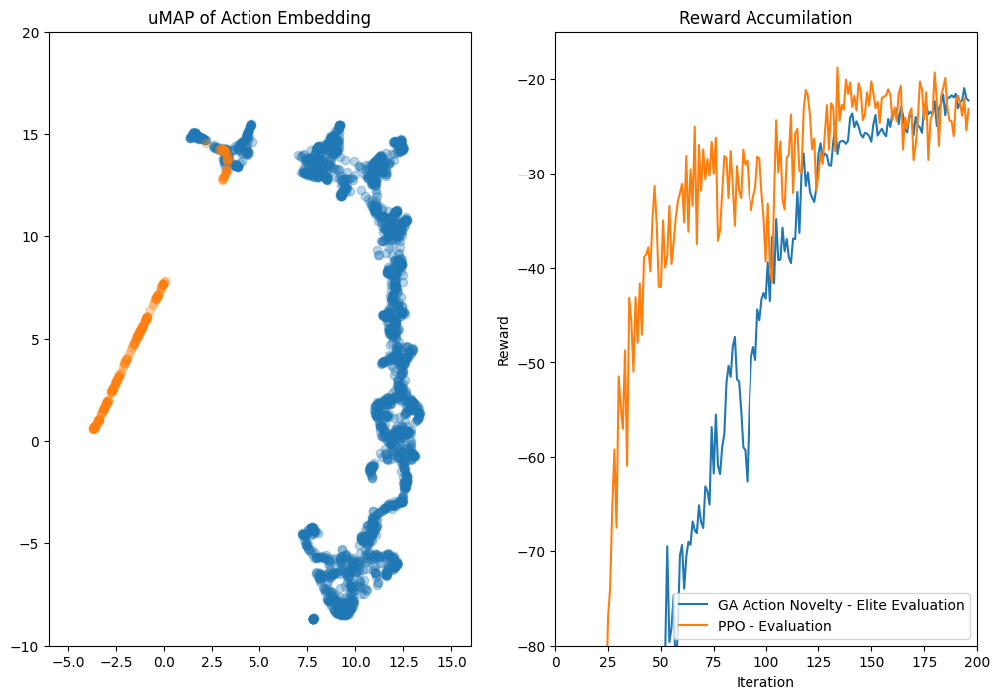

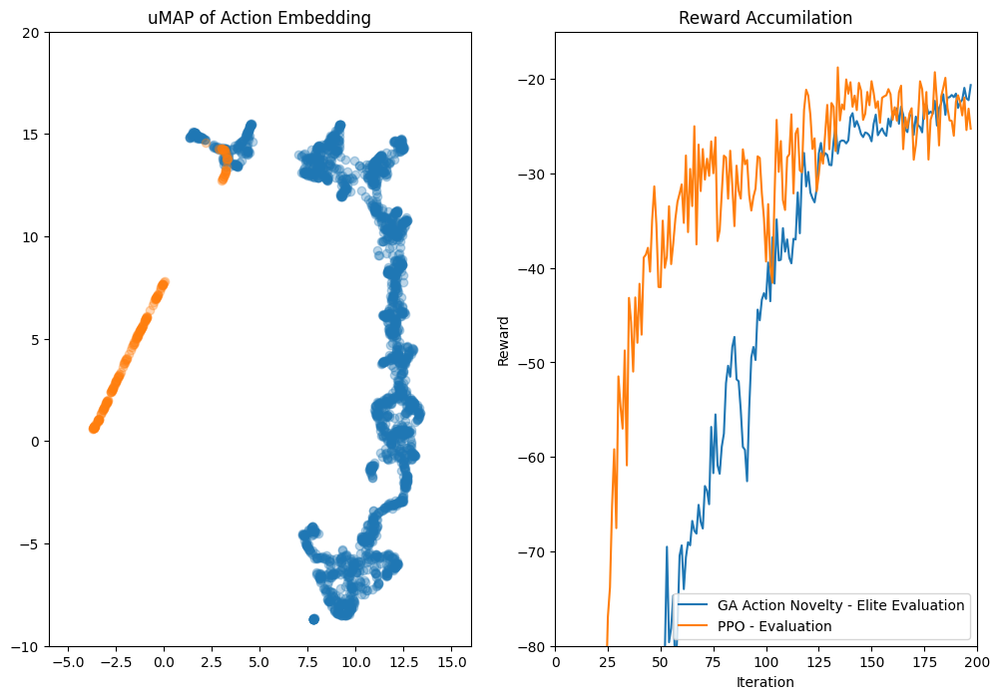

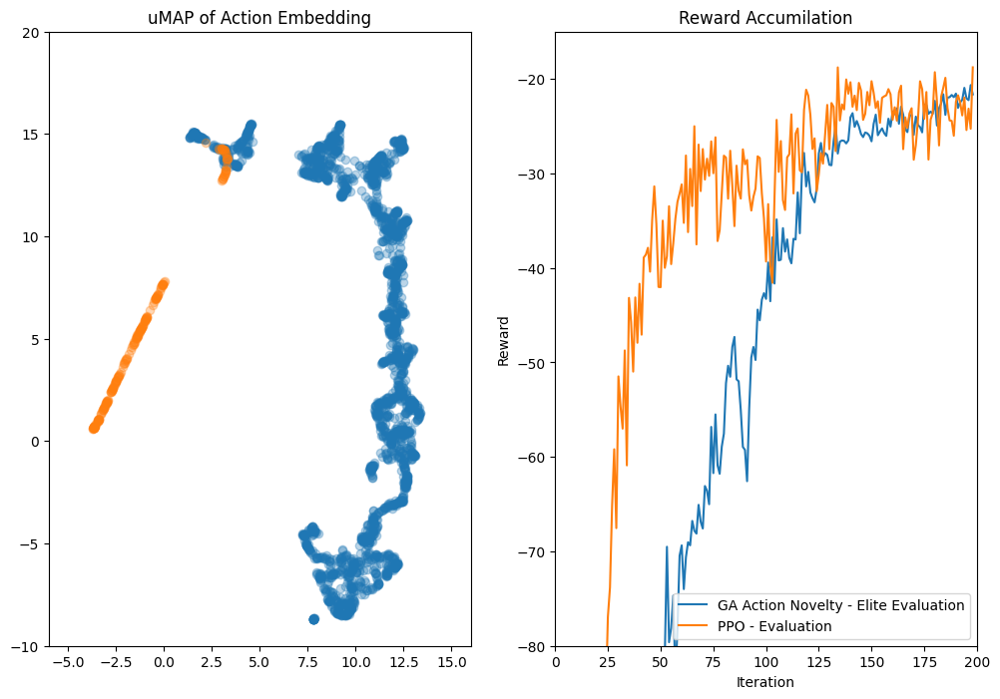

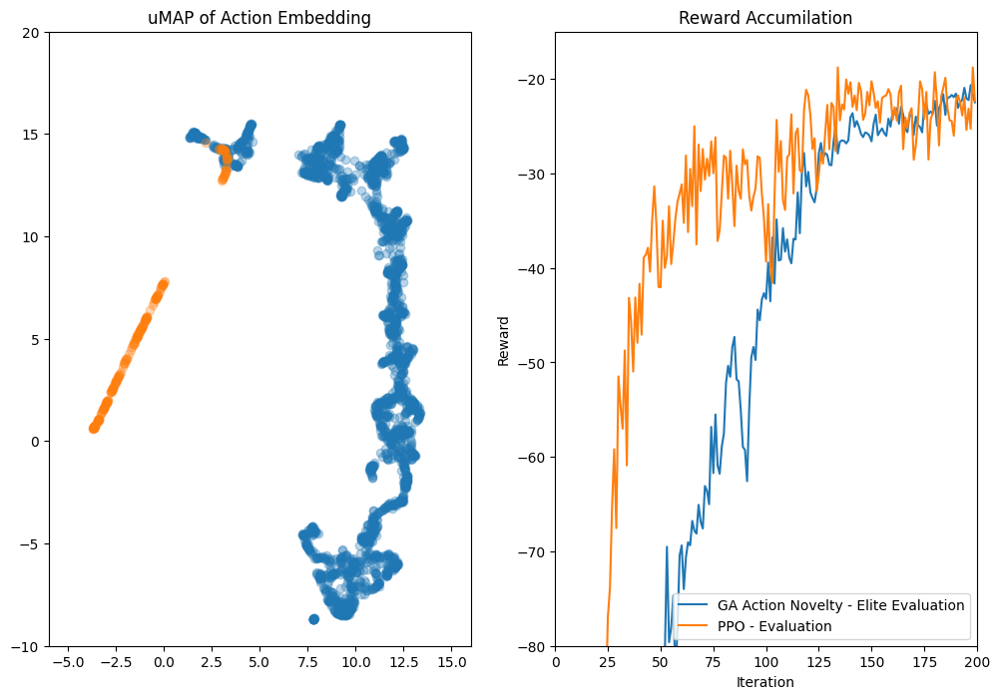

In [27]:
plt.show()

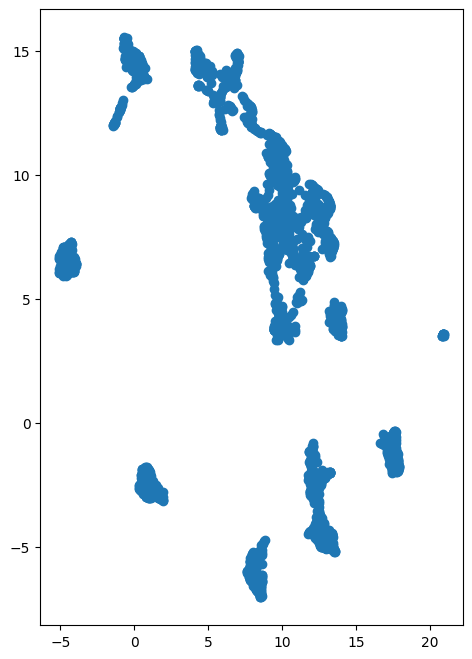

In [21]:

fig = plt.figure(figsize=(12, 8), dpi=100)

ax = plt.subplot(1, 2, 1)
ax.scatter(umap_embedding[:,0], umap_embedding[:,1])
plt.show()



In [35]:
with open('fml.txt') as f:
    lines = f.readlines()
reward = []
for l in lines:
    if "eps 100 is: " in l: 
        reward.append(float((l[59:64])))

In [11]:
import numpy as np
np.load('85_data_a_archive.npy').shape[0]

2376

	                                                 Validated Test Scores
                                    30 steps	           50 steps	            100 steps
	                         B-line	Meander	Sleep	B-line	Meander	Sleep	B-line	Meander	Sleep
H PPO w Cur	 -30.07 ± 0.67	 -2.63	-2.28	0	    -4.71	-3.60	0	    -11.01	-5.84	0
H PPO	     -49.35 ± 0.37	 -3.87	-3.27	0	    -6.81	-6.66	0	    -14.06	-14.68  0
DDQN w RNN	 -119.01 ± 2.29	 -6.87	-6.00	0	    -12.67	-16.87	0	    -27.47	-49.13	0
DDQN	     -213.76 ± 6.45	 -8.10	-9.39	0	    -19.22	-30.62	0	    -59.66	-86.77	0